## Final Project Submission

Please fill out:
* Student name: Mohammed Siddiqui
* Student pace: full time
* Scheduled project review date/time: 3/27/2021 4pm CST
* Instructor name: Victor Geislinger/Claude Fried
* Blog post URL:


In [2]:
import numpy as np # linear algebra
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.formula.api import ols
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import scipy.stats as stats


sns.set_style("whitegrid")
%matplotlib inline

sns.set(rc={'figure.figsize':(11,8)})

In [3]:
# Import housing data
df_full = pd.read_csv("data\kc_house_data.csv")

Business Problem:
 * Microsoft has hired us to help them find housing for new hires.
 * They would like us to make a model to predict housing prices.
 * From that model, they would like to know which factors have the largest effect on price.

# 1. Data Overview

We will be using the King County Housing dataset which provides us with data about house sales in 2014 and 2015.

## 1.1 Description of Features

price: Sales price of the property sold.  This will be our prediction target.

bedrooms: Number of bedrooms.

bathrooms: Number of bathrooms.

sqft_living: Interior living space in square feet.

sqft_lot: Lot size in square feet.

floors: Number of floors.

waterfront: If the house is located next to water.

view: How nice the view of the house is.

condition: Condition of the house on a scale of 1-5, with 5 being the best.

grade: Grade given based on the quality of the house on a scale of 1-13, with 13 being the best.

sqft_above: Living area above ground in square feet.

sqft_basement: Living area below ground in square feet.

yr_built: Year built.

yr_renovated: Year renovated, if it was.

zipcode: Zipcode.

lat: Latitude.

long: Longitude.

sqft_living15: Interior living area of the closest 15 neighbors.

sqft_lot15: Lot area of the closese 15 neighbors.

note: There is a discrepancy between the columns.md document and other interpretations of column meanings on Kaggle.  I went with the latter.



For now, we won't use yr_renovated, sqft_living15 and sqft_lot15.  We can add them on later if necessary.

## 1.2 Cursory look and preliminary cleanup

In [4]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [5]:
df_full.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,...,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,...,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


* We've got a fair share of null values in yr_renovated and waterfront.
* View category has some values missing.
* The columns for date and sqft_basement need to be converted to datetime and int/float

In [6]:
# Fill in null values in view and waterfront with 0
df_full['view'] = df_full['view'].fillna(0)
df_full['waterfront'] = df_full['waterfront'].fillna(0)

# Replace the '?' with a 0.
df_full['sqft_basement'] = df_full['sqft_basement'].replace(to_replace='?', value= 0)

In [7]:
# Select features of interest
df = df_full[['id', 'sqft_lot', 'sqft_living',
                    'grade', 'condition', 'sqft_basement'
                    , 'bathrooms', 'bedrooms',
                    'date', 'waterfront', 'view', 'price', 'floors', 'zipcode', 'lat', 'long']]

# 2. Data Analysis and Feature Engineering

* These are the features we will be exploring

In [8]:
df.corr()

,id,sqft_lot,sqft_living,grade,condition,bathrooms,bedrooms,waterfront,view,price,floors,zipcode,lat,long
id,1.000000,-0.131911,-0.012241,0.008188,-0.023803,0.005162,0.001150,-0.003599,0.011772,-0.016772,0.018608,-0.008211,-0.001798,0.020672
sqft_lot,-0.131911,1.000000,0.173453,0.114731,-0.008830,0.088373,0.032471,0.021459,0.075054,0.089876,-0.004814,-0.129586,-0.085514,0.230227
sqft_living,-0.012241,0.173453,1.000000,0.762779,-0.059445,0.755758,0.578212,0.104637,0.281715,0.701917,0.353953,-0.199802,0.052155,0.241214
grade,0.008188,0.114731,0.762779,1.000000,-0.146896,0.665838,0.356563,0.082818,0.249082,0.667951,0.458794,-0.185771,0.113575,0.200341
condition,-0.023803,-0.008830,-0.059445,-0.146896,1.000000,-0.126479,0.026496,0.016648,0.045622,0.036056,-0.264075,0.002888,-0.015102,-0.105877
bathrooms,0.005162,0.088373,0.755758,0.665838,-0.126479,1.000000,0.514508,0.063629,0.186016,0.525906,0.502582,-0.204786,0.024280,0.224903
bedrooms,0.001150,0.032471,0.578212,0.356563,0.026496,0.514508,1.000000,-0.002127,0.078354,0.308787,0.177944,-0.154092,-0.009951,0.132054
waterfront,-0.003599,0.021459,0.104637,0.082818,0.016648,0.063629,-0.002127,1.000000,0.380543,0.264306,0.020797,0.028923,-0.012157,-0.037628
view,0.011772,0.075054,0.281715,0.249082,0.045622,0.186016,0.078354,0.380543,1.000000,0.393497,0.028414,0.085059,0.006321,-0.077702
price,-0.016772,0.089876,0.701917,0.667951,0.036056,0.525906,0.308787,0.264306,0.393497,1.000000,0.256804,-0.053402,0.306692,0.022036


* sqft_living, grade, bathrooms, view and waterfront appear to to be correlated fairly well with price.
* We will deal with multicollinearity a bit later after feature engineering.

## 2.1 Target Variable

In [9]:
df.price.describe()

count    2.159700e+04
mean     5.402966e+05
std      3.673681e+05
min      7.800000e+04
25%      3.220000e+05
50%      4.500000e+05
75%      6.450000e+05
max      7.700000e+06
Name: price, dtype: float64

<AxesSubplot:xlabel='price', ylabel='Count'>

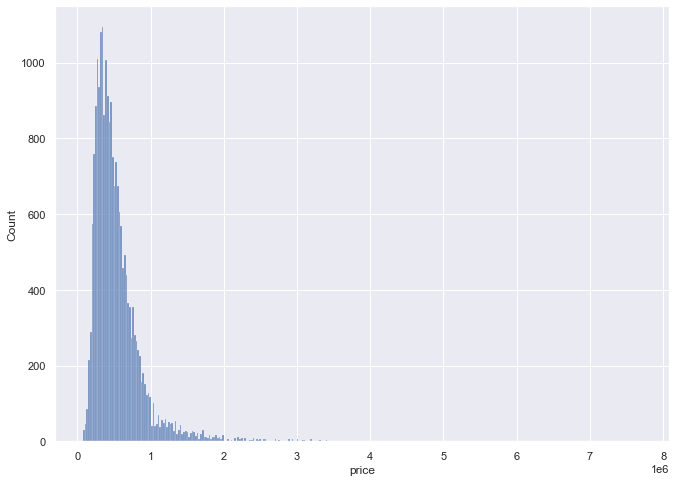

In [10]:
sns.histplot(df.price)

* We've got a really big skew here to the right.
* Let's see what the 99th percentile for the prices is.

In [11]:
# Find the price for the 99th percentile
pct99 =np.percentile(df['price'], 99)
pct99

1970000.0

In [12]:
# Filter out top 1%
df = df[df['price'] <= pct99 ]
df99= df

*  We've lost the top 1% of houses by price
*  This should help us get a better model for 99% of homes.

<AxesSubplot:xlabel='price', ylabel='Count'>

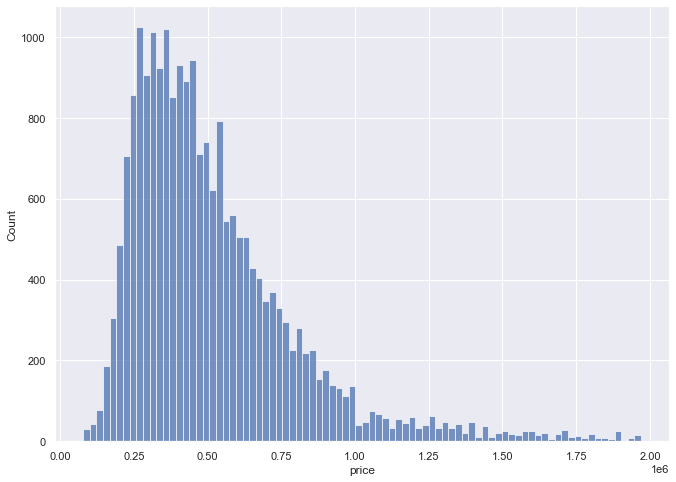

In [13]:
sns.histplot(df.price)

*  This looks much more reasonable.
*  There is still a skew

In [14]:
df.price.describe()

count    2.138300e+04
mean     5.185033e+05
std      2.852752e+05
min      7.800000e+04
25%      3.200000e+05
50%      4.500000e+05
75%      6.350000e+05
max      1.970000e+06
Name: price, dtype: float64

<AxesSubplot:xlabel='price', ylabel='Count'>

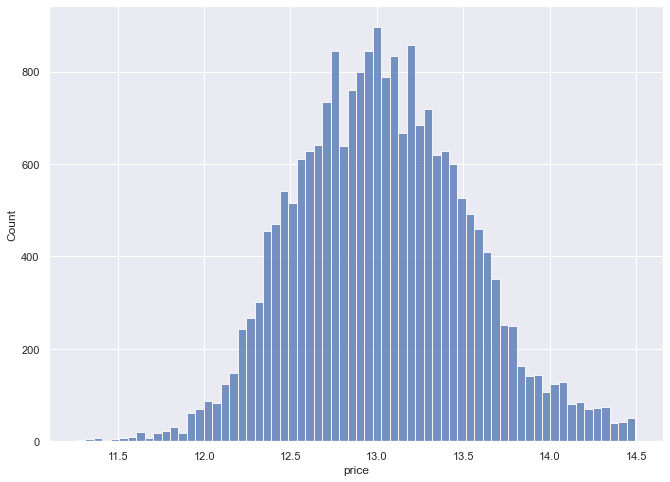

In [15]:
sns.histplot(np.log(df.price))

* This distribution looks a lot more normal than the previous, but we still see the tail thicker on the right side.

## 2.2 Features

In [16]:
df.sqft_living.describe()

count    21383.000000
mean      2051.204321
std        861.353869
min        370.000000
25%       1420.000000
50%       1900.000000
75%       2520.000000
max       7730.000000
Name: sqft_living, dtype: float64

<AxesSubplot:xlabel='sqft_living', ylabel='Count'>

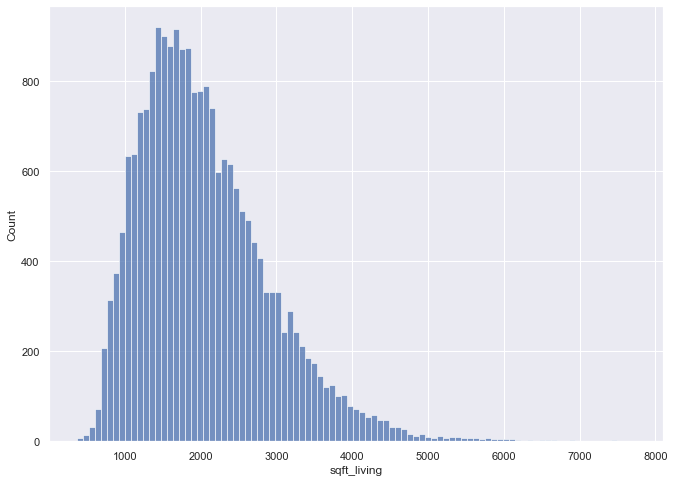

In [17]:
sns.histplot(df['sqft_living'])

This is clearly skewed right.  Let's try its log to see if we can get a more normal distribution.

<AxesSubplot:xlabel='sqft_living', ylabel='Count'>

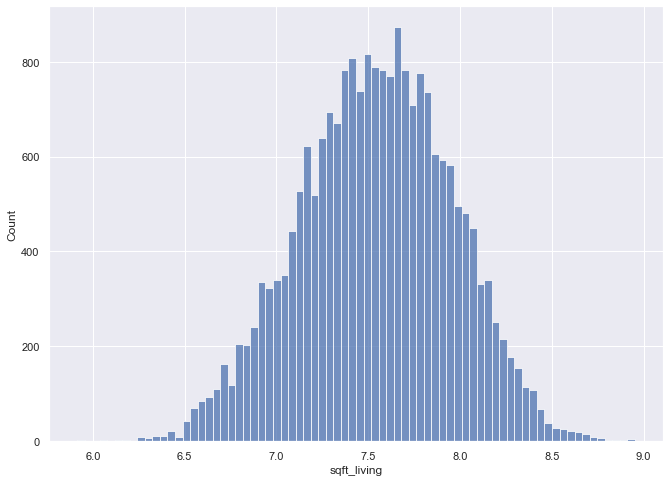

In [18]:
sns.histplot(np.log(df['sqft_living']))

This is certainly a lot better.

<AxesSubplot:xlabel='sqft_lot', ylabel='Count'>

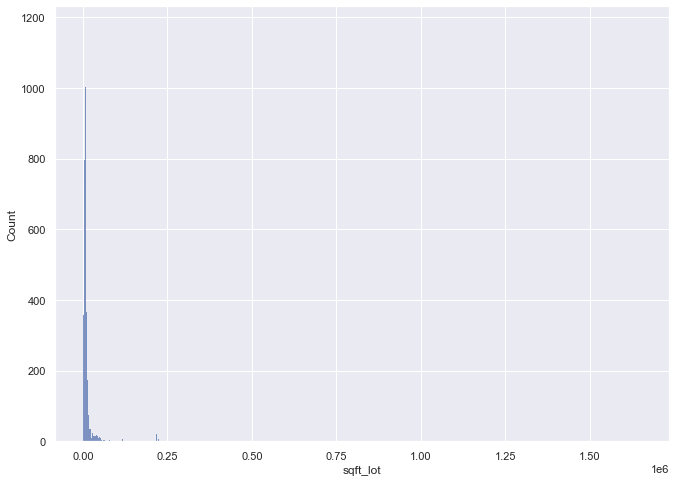

In [19]:
sns.histplot(df.sqft_lot)

<AxesSubplot:xlabel='sqft_lot', ylabel='Count'>

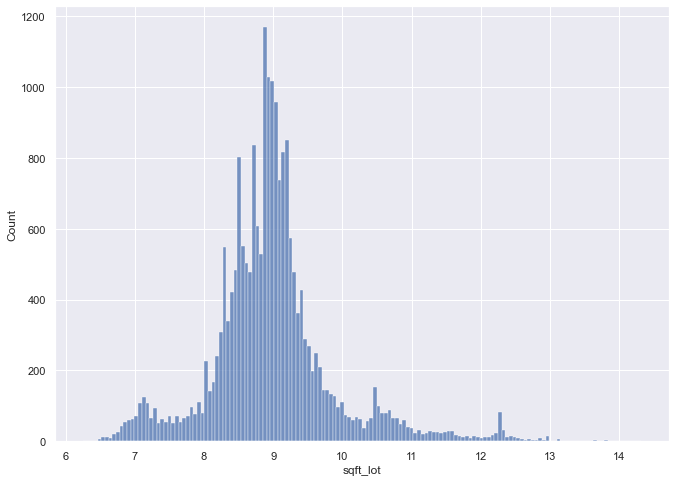

In [20]:
sns.histplot(np.log(df.sqft_lot))

* The regular histogram is incredibly hard to decipher.
* Even when logged, we notice that the distribution isn't quite normal.  There seem to be four modes.
* Since the correlation with price isn't all that high anyway, we will probably end up dropping this feature later on.

###  2.2.1 Location, location, location

Based on plain logic, location should be very important to the price of any property.  I'm hoping that the data provided here can provide some useful insights.

[Text(0.5, 0, 'Longitude'),
 Text(0, 0.5, 'Latitude'),
 Text(0.5, 1.0, 'Price by Location')]

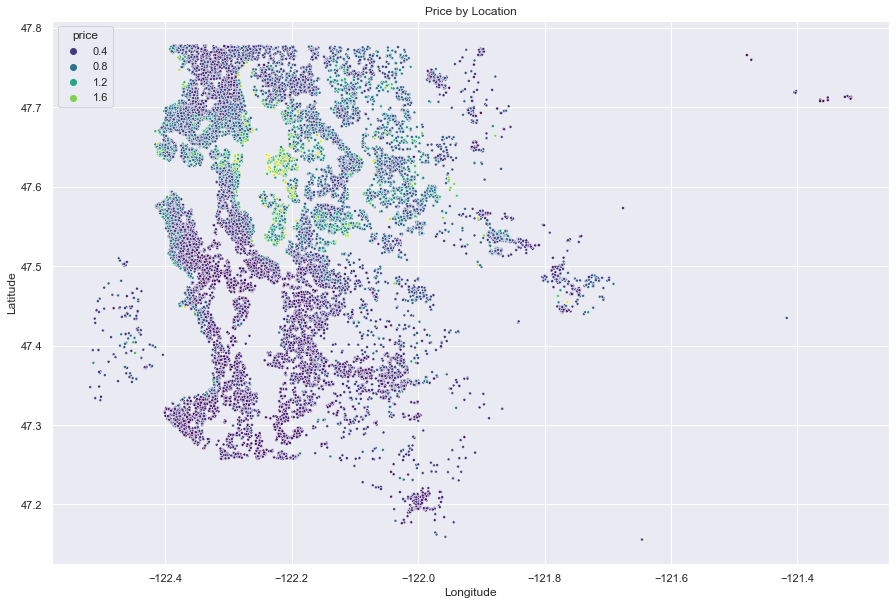

In [21]:
fig = plt.figure(figsize=(15,10))
ax = sns.scatterplot(x=df['long'], y=df['lat'], hue=df['price'], palette='viridis',
                     marker='.')
ax.set( xlabel='Longitude',
        ylabel='Latitude', 
        title='Price by Location'  )

* We can see that the more expensive houses appear to be concentrated in certain areas.

<AxesSubplot:xlabel='lat', ylabel='price'>

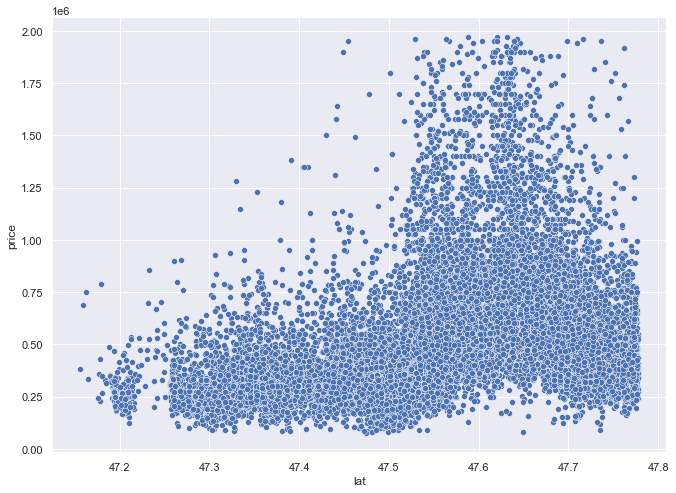

In [22]:
sns.scatterplot(x=df['lat'], y=df['price'])

* In terms of latitude, we can see that a particular area has higher prices.  
* We can engineer this feature to show how far away a house is from the latitude of 47.63

In [23]:

df['lat'] = df['lat'].apply(lambda x: abs(x - 47.63))

<AxesSubplot:xlabel='long', ylabel='price'>

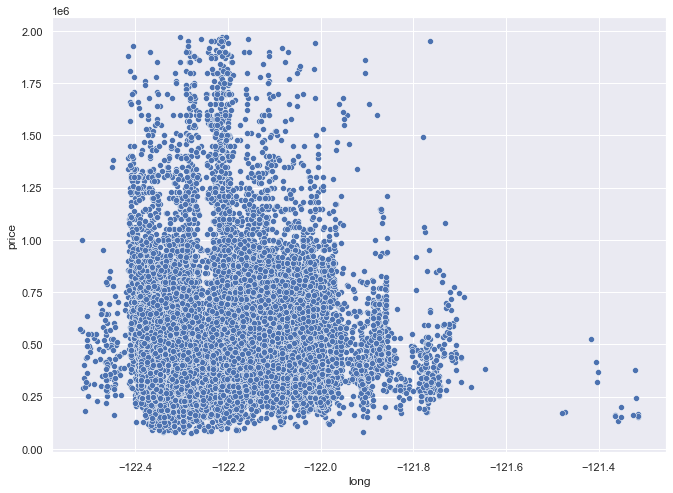

In [24]:
sns.scatterplot(x=df['long'], y=df['price'])

* While there are areas with higher prices, longitude is harder to do the same type of feature engineering.
* We'll try to use this as-is, but I can see the houses in the west causing some issues.

### 2.2.2 Dealing with zipcodes

Since the numbers in themselves offer little value, we will need to turn them into something we can use.

Let's  import the median incomes for each zip code.

Source: Census.gov

In [25]:
df_zip = pd.read_excel('data\ZIP_codes_2018.xls')
df_zip = df_zip[['ZIP Code', 'Median family income (2018)']]
df_zip

,ZIP Code,Median family income (2018)
0,501,NaN
1,544,NaN
2,601,14433.0
3,602,19250.0
4,603,19718.0
...,...,...
41271,99926,65313.0
41272,99927,NaN
41273,99928,NaN
41274,99929,71923.0


In [26]:
df_zt = df[['id', 'zipcode']]
zip_mult = df_zt.zipcode.replace(df_zip.set_index('ZIP Code')['Median family income (2018)'])


In [27]:
df = df.drop('zipcode', 1)
df = pd.concat([df, zip_mult], axis=1)
df = df.rename(columns={'zipcode': 'zip_med_inc'})

In [28]:
df['zip_med_inc'].isna().any()

False

In [29]:
df['zip_med_inc'].head(10)

0     81411.0
1     89351.0
2    126230.0
3    136917.0
4    183024.0
5    158498.0
6     63079.0
7     73710.0
8     73989.0
9    115669.0
Name: zip_med_inc, dtype: float64

<AxesSubplot:xlabel='zip_med_inc', ylabel='price'>

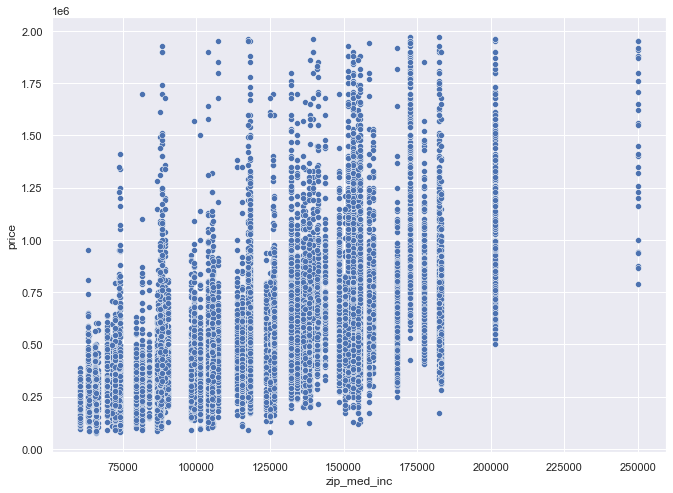

In [30]:
sns.scatterplot(x=df['zip_med_inc'], y=df['price'])

* We can now use this continuous variable

## 2.3 Categorical Features

In [31]:
df.bedrooms.describe()

count    21383.000000
mean         3.363607
std          0.920616
min          1.000000
25%          3.000000
50%          3.000000
75%          4.000000
max         33.000000
Name: bedrooms, dtype: float64

In [32]:
df.bedrooms.value_counts(normalize=True)

3     0.457794
4     0.317355
2     0.128981
5     0.072020
6     0.012112
1     0.009166
7     0.001543
8     0.000514
9     0.000281
10    0.000140
11    0.000047
33    0.000047
Name: bedrooms, dtype: float64

* We have a definite outlier here with 33 bedrooms.


<AxesSubplot:xlabel='bedrooms', ylabel='price'>

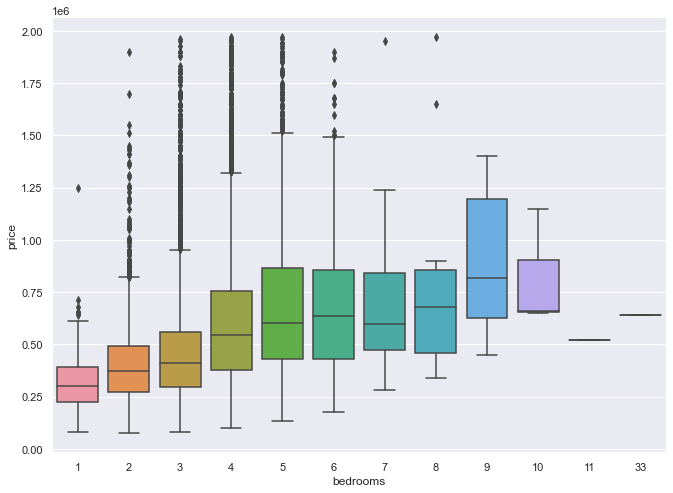

In [33]:
sns.boxplot(data=df, x='bedrooms', y='price')

* Just looking at this, I will label any house with 5+ bedrooms as having 5 bedrooms

In [34]:
def bed_fix(x):
     if x > 5:
        return 5
     else:
        return x

In [35]:
df['bedrooms'] = df['bedrooms'].apply(bed_fix)

In [36]:
df['bedrooms'].value_counts(normalize=True)

3    0.457794
4    0.317355
2    0.128981
5    0.086704
1    0.009166
Name: bedrooms, dtype: float64

* Even with the combined 5+ category, it's still less than 9% of the houses.

<AxesSubplot:xlabel='bedrooms', ylabel='price'>

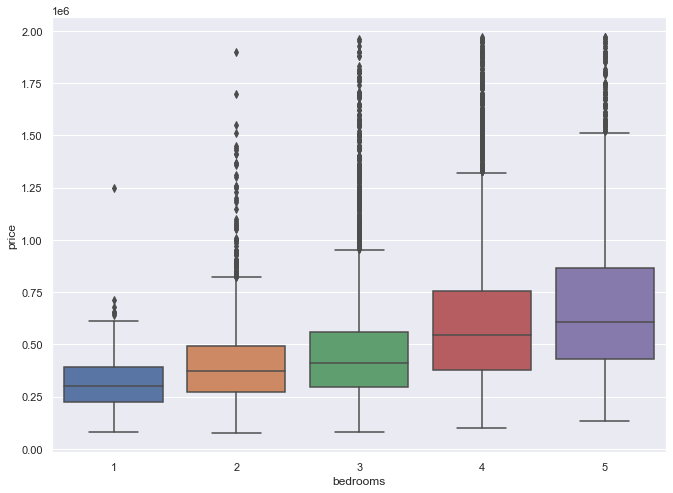

In [37]:
sns.boxplot(data=df, x='bedrooms', y='price')

In [38]:
df.bathrooms.describe()

count    21383.000000
mean         2.098735
std          0.745857
min          0.500000
25%          1.500000
50%          2.250000
75%          2.500000
max          7.500000
Name: bathrooms, dtype: float64

<AxesSubplot:xlabel='bathrooms', ylabel='Count'>

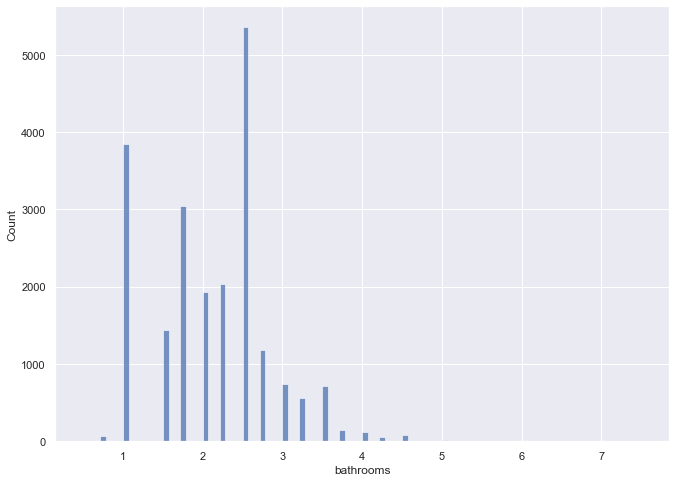

In [39]:
sns.histplot(df['bathrooms'])

In [40]:
df.bathrooms.value_counts()

2.50    5358
1.00    3851
1.75    3046
2.25    2041
2.00    1929
1.50    1445
2.75    1180
3.00     735
3.50     710
3.25     555
3.75     141
4.00     115
4.50      87
0.75      71
4.25      59
5.00      16
4.75      10
1.25       9
5.25       9
5.50       4
0.50       4
5.75       3
6.00       2
7.50       1
6.75       1
6.50       1
Name: bathrooms, dtype: int64

*  Having partial bathrooms just makes the visuals look cluttered
*  We'll make the column about full bathrooms

In [41]:
df

,id,sqft_lot,sqft_living,grade,condition,sqft_basement,bathrooms,bedrooms,date,waterfront,view,price,floors,lat,long,zip_med_inc
0,7129300520,5650,1180,7,3,0.0,1.00,3,10/13/2014,0.0,0.0,221900.0,1.0,0.1188,-122.257,81411.0
1,6414100192,7242,2570,7,3,400.0,2.25,3,12/9/2014,0.0,0.0,538000.0,2.0,0.0910,-122.319,89351.0
2,5631500400,10000,770,6,3,0.0,1.00,2,2/25/2015,0.0,0.0,180000.0,1.0,0.1079,-122.233,126230.0
3,2487200875,5000,1960,7,5,910.0,3.00,4,12/9/2014,0.0,0.0,604000.0,1.0,0.1092,-122.393,136917.0
4,1954400510,8080,1680,8,3,0.0,2.00,3,2/18/2015,0.0,0.0,510000.0,1.0,0.0132,-122.045,183024.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,1131,1530,8,3,0.0,2.50,3,5/21/2014,0.0,0.0,360000.0,3.0,0.0693,-122.346,134097.0
21593,6600060120,5813,2310,8,3,0.0,2.50,4,2/23/2015,0.0,0.0,400000.0,2.0,0.1193,-122.362,73989.0
21594,1523300141,1350,1020,7,3,0.0,0.75,2,6/23/2014,0.0,0.0,402101.0,2.0,0.0356,-122.299,88413.0
21595,291310100,2388,1600,8,3,0.0,2.50,3,1/16/2015,0.0,0.0,400000.0,2.0,0.0955,-122.069,131985.0


In [42]:
# Added one at the end because a value of 0 from the truncation won't play well
df['bathrooms'] = df['bathrooms'].round() + 1

<AxesSubplot:xlabel='bathrooms', ylabel='price'>

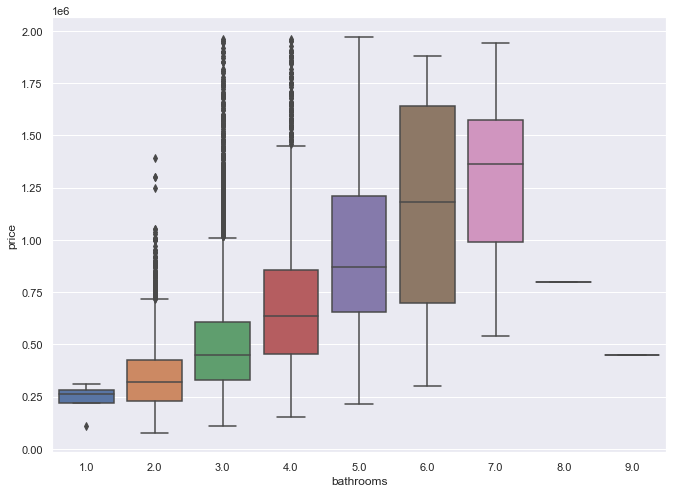

In [43]:
sns.boxplot(data=df, x='bathrooms', y='price')

In [44]:
df['sqft_basement'].value_counts()

0.0       12770
0           450
600.0       215
500.0       209
700.0       205
          ...  
784.0         1
415.0         1
2180.0        1
506.0         1
2190.0        1
Name: sqft_basement, Length: 291, dtype: int64

In [45]:

df['sqft_basement'] = df['sqft_basement'].astype(bool).astype(int)

In [46]:
df.view.value_counts()

0.0    19409
2.0      927
3.0      481
1.0      317
4.0      249
Name: view, dtype: int64

In [47]:
df.grade.value_counts(normalize=True)

7     0.419632
8     0.283356
9     0.121358
6     0.095309
10    0.050040
11    0.015152
5     0.011317
12    0.002479
4     0.001263
13    0.000047
3     0.000047
Name: grade, dtype: float64

In [48]:
def gr_fix(x):
    if x < 8:
        return 1
    elif x < 11:
        return 2
    elif x <13:
        return 3
    else:
        return 4

In [49]:
df['grade'] = df['grade'].apply(gr_fix)

<AxesSubplot:xlabel='grade', ylabel='price'>

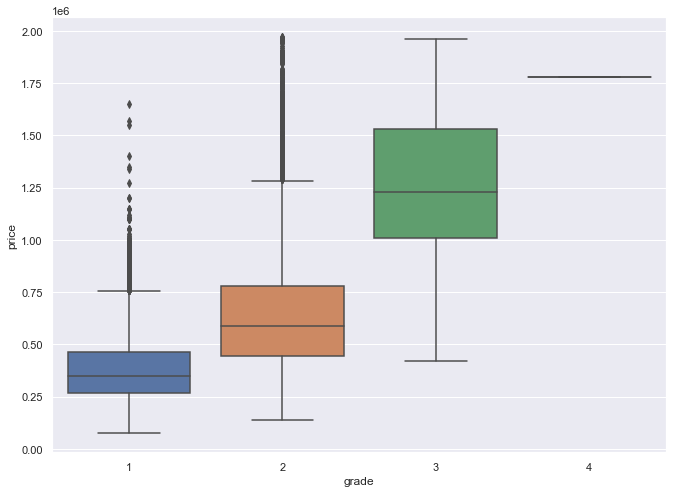

In [50]:
sns.boxplot(data=df, x='grade', y='price')

<AxesSubplot:xlabel='condition', ylabel='price'>

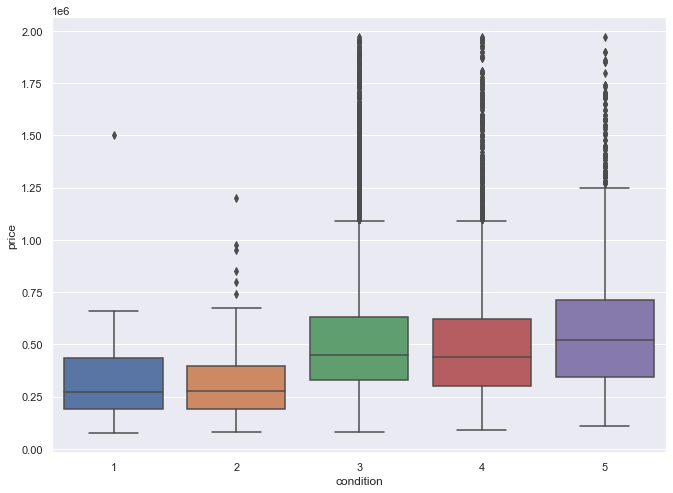

In [51]:
sns.boxplot(data=df, x='condition', y='price')

In [52]:
df.condition.value_counts()

3    13887
4     5629
5     1669
2      169
1       29
Name: condition, dtype: int64

*  There does seem to be an increase in price if the condition is 3 or higher
*  Something to note here is that the correlation with price is around 0.03

In [53]:
df.waterfront = df.waterfront.fillna(0)

<AxesSubplot:xlabel='waterfront', ylabel='price'>

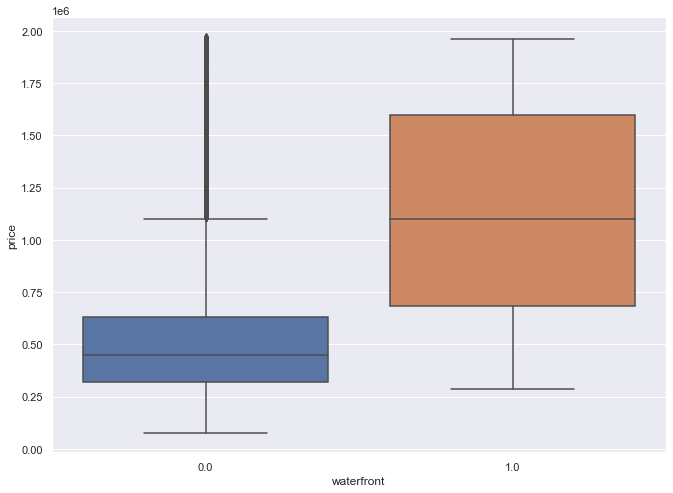

In [54]:
sns.boxplot(data=df, x='waterfront', y='price')

* This is a big jump in mean price

<AxesSubplot:xlabel='floors', ylabel='price'>

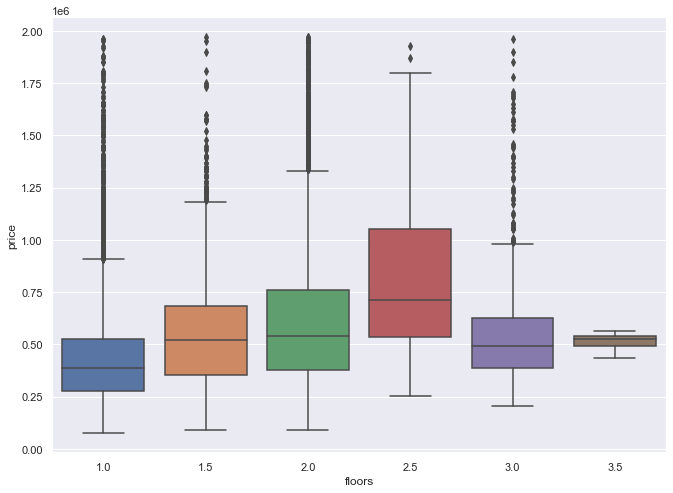

In [55]:
sns.boxplot(data=df, x='floors', y='price')

<AxesSubplot:xlabel='sqft_basement', ylabel='price'>

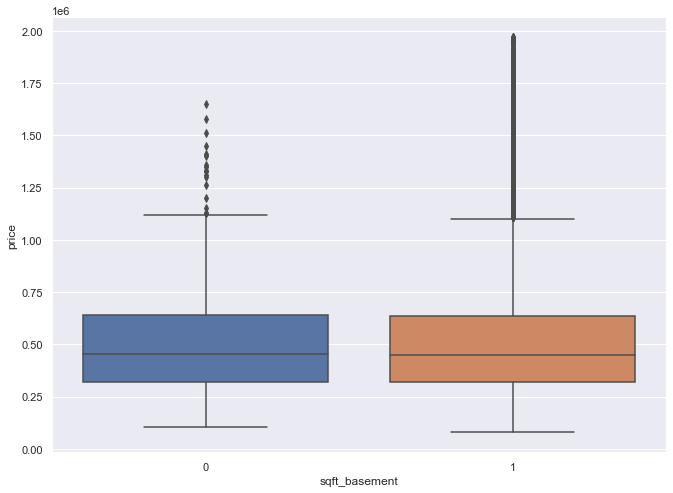

In [56]:
sns.boxplot(data=df, x='sqft_basement', y='price')

* This will almost certainly be discarded

<AxesSubplot:xlabel='view', ylabel='price'>

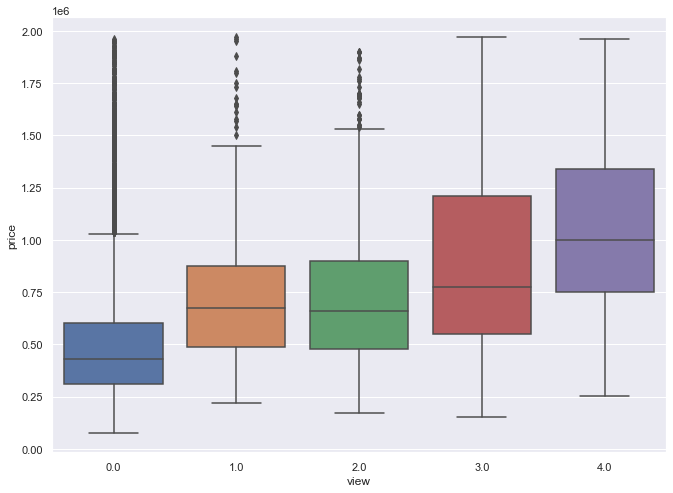

In [57]:
sns.boxplot(data=df, x='view', y='price')

In [58]:
df.view.value_counts(normalize=True)

0.0    0.907684
2.0    0.043352
3.0    0.022495
1.0    0.014825
4.0    0.011645
Name: view, dtype: float64

In [59]:
df['view'] = df['view'].astype(bool).astype(int)

* I'm not too confident about how useful this feature is
* Over 90% of the values are 0, including some missing values that we filled.

## 2.3 Look for Multicolinearity

In [60]:
abs(df.corr()) > 0.70

,id,sqft_lot,sqft_living,grade,condition,sqft_basement,bathrooms,bedrooms,waterfront,view,price,floors,lat,long,zip_med_inc
id,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False
sqft_lot,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False
sqft_living,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False
grade,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False
condition,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False
sqft_basement,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False
bathrooms,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False
bedrooms,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False
waterfront,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False
view,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False


*  There are no correlations above 0.70

In [61]:
corr_matrix = df.corr()
print(corr_matrix["price"].sort_values(ascending=False))

price            1.000000
sqft_living      0.678879
zip_med_inc      0.595419
grade            0.565440
bathrooms        0.495749
bedrooms         0.328915
view             0.325708
floors           0.279025
waterfront       0.141654
sqft_lot         0.098359
long             0.041649
condition        0.036882
sqft_basement    0.003495
id              -0.011516
lat             -0.492935
Name: price, dtype: float64


* Living area and zipcode median income have the highest correlations with price

In [62]:
df_clean = df
realprice = pd.DataFrame.copy(df['price'])

In [63]:
df = df.drop(['id', 'date'], axis= 1)

# 3. Iterative Modeling

## 3.1 Model 0

Let's run a model just to see where our features currently stand.

In [64]:
X = df.drop('price', 1)
y =df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=11)

In [65]:
predictors = sm.add_constant(X_train)
model_0 = sm.OLS(y_train , predictors).fit()
model_0.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.760
Model:                            OLS   Adj. R-squared:                  0.760
Method:                 Least Squares   F-statistic:                     4162.
Date:                Thu, 25 Mar 2021   Prob (F-statistic):               0.00
Time:                        13:52:13   Log-Likelihood:            -2.2697e+05
No. Observations:               17106   AIC:                         4.540e+05
Df Residuals:                   17092   BIC:                         4.541e+05
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const         -3.952e+07   1.08e+06    -36.693      0.000   -4.16e+07   -3.74e+07
sqft_lot          0.3329      0.028     12.011      0.000       0.279       0.387
sqft_living     167.7027      2.234     75.057      0.000     163.323     172.082
grade           6.64e+04   2798.685     23.727      0.000    6.09e+04    7.19e+04
condition      3.184e+04   1735.468     18.349      0.000    2.84e+04    3.52e+04
sqft_basement  3678.7750   7661.873      0.480      0.631   -1.13e+04    1.87e+04
bathrooms      1.317e+04   2082.731      6.325      0.000    9090.595    1.73e+04
bedrooms      -1.507e+04   1645.017     -9.161      0.000   -1.83e+04   -1.18e+04
waterfront     4.173e+05   1.61e+04     25.927      0.000    3.86e+05    4.49e+05
view           1.141e+05   3985.930     28.631      0.000    1.06e+05    1.22e+05
floors        -2067.1629   2358.305     -0.877      0.381   -6689.684    2555.358
lat           -6.938e+05    1.5e+04    -46.265      0.000   -7.23e+05   -6.64e+05
long          -3.212e+05   8791.172    -36.537      0.000   -3.38e+05   -3.04e+05
zip_med_inc       2.5433      0.046     54.996      0.000       2.453       2.634
==============================================================================
Omnibus:                     5784.405   Durbin-Watson:                   2.007
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            38004.021
Skew:                           1.467   Prob(JB):                         0.00
Kurtosis:                       9.686   Cond. No.                     1.26e+08
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.26e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

* R-Squred value is pretty good, but we've already done a fair share of feature engineering
* sqft_basement has a high p-value, so it should be removed
* We've got to deal with the very high Condition number

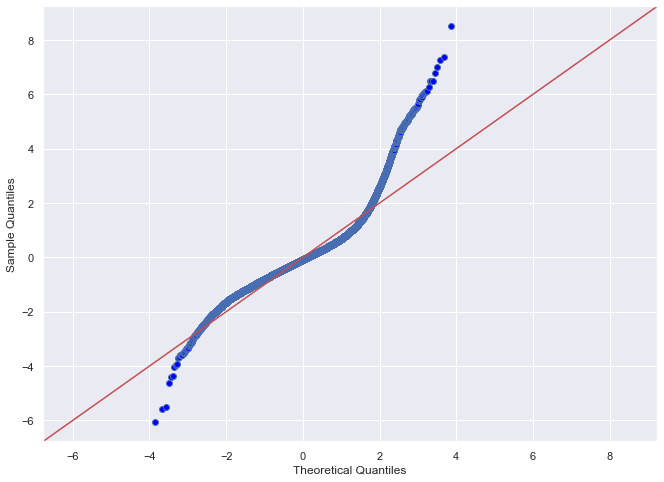

In [66]:
fig = sm.graphics.qqplot(model_0.resid, dist=stats.norm, line='45', fit=True)

* This residual plot is certainly not great, but we should be able to improve

## 3.2 Model 1

We will make two changes for this model:
* Create dummy variables for grade and condition
* Log transform some of our variables

In [67]:
grade_dummies = pd.get_dummies(df['grade'], prefix='grade', drop_first=True)
cond_dummies = pd.get_dummies(df['condition'], prefix='cond', drop_first=True)

df = df.drop([ 'grade', 'condition'], axis=1)

df = pd.concat([df, grade_dummies, cond_dummies], axis=1)


In [68]:
df[['sqft_lot', 'sqft_living', 'zip_med_inc', 'bedrooms', 'bathrooms']] = np.log(df[['sqft_lot', 'sqft_living', 'zip_med_inc', 'bedrooms', 'bathrooms']])


In [69]:
price_log = np.log(df.price)
price_log = pd.DataFrame(price_log)

In [70]:
X = df.drop('price', 1)
y =price_log

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=11)

In [71]:
predictors = sm.add_constant(X_train)
model_1 = sm.OLS(y_train , predictors).fit()
model_1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.819
Model:                            OLS   Adj. R-squared:                  0.819
Method:                 Least Squares   F-statistic:                     4292.
Date:                Thu, 25 Mar 2021   Prob (F-statistic):               0.00
Time:                        13:52:14   Log-Likelihood:                 2219.3
No. Observations:               17106   AIC:                            -4401.
Df Residuals:                   17087   BIC:                            -4253.
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const           -66.8624      1.755    -38.104      0.000     -70.302     -63.423
sqft_lot          0.0525      0.002     22.087      0.000       0.048       0.057
sqft_living       0.5209      0.008     67.717      0.000       0.506       0.536
sqft_basement    -0.0062      0.012     -0.530      0.596      -0.029       0.017
bathrooms         0.0790      0.010      7.817      0.000       0.059       0.099
bedrooms         -0.0674      0.008     -8.391      0.000      -0.083      -0.052
waterfront        0.4574      0.024     18.680      0.000       0.409       0.505
view              0.1705      0.006     28.278      0.000       0.159       0.182
floors            0.0390      0.004      9.974      0.000       0.031       0.047
lat              -1.7257      0.023    -73.971      0.000      -1.771      -1.680
long             -0.5656      0.014    -40.417      0.000      -0.593      -0.538
zip_med_inc       0.5278      0.008     65.130      0.000       0.512       0.544
grade_2           0.1254      0.004     28.456      0.000       0.117       0.134
grade_3           0.3414      0.014     24.475      0.000       0.314       0.369
grade_4           0.9007      0.213      4.233      0.000       0.484       1.318
cond_2            0.1139      0.046      2.481      0.013       0.024       0.204
cond_3            0.2732      0.042      6.522      0.000       0.191       0.355
cond_4            0.3171      0.042      7.564      0.000       0.235       0.399
cond_5            0.3799      0.042      8.996      0.000       0.297       0.463
==============================================================================
Omnibus:                      499.667   Durbin-Watson:                   2.006
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1316.154
Skew:                           0.001   Prob(JB):                    1.59e-286
Kurtosis:                       4.359   Cond. No.                     1.33e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.33e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

* Our R-squared is now improved
* Issue with the Cond. No. is still there
* Kurtosis has gotten better

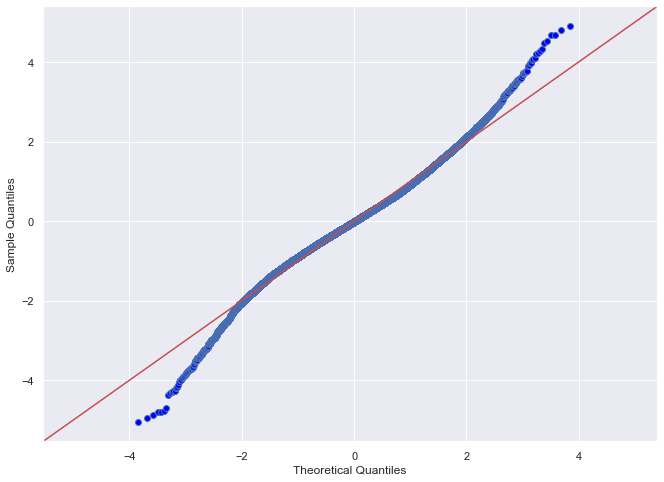

In [72]:
fig = sm.graphics.qqplot(model_1.resid, dist=stats.norm, line='45', fit=True)

* Residual plot has improved.

## 3.3 Model 2

The main goal of this model is to see if scaling helps in any way.

In [73]:
X = df.drop('price', 1)
y =price_log

In [74]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=11)

In [75]:
scaler = StandardScaler()
scalerp = StandardScaler()

X_train[['sqft_lot', 'sqft_living', 'bathrooms', 'bedrooms', 'floors', 'lat', 'long', 'zip_med_inc']]  =scaler.fit_transform(X_train[['sqft_lot', 'sqft_living', 'bathrooms', 'bedrooms', 'floors', 'lat', 'long', 'zip_med_inc']])


X_test[['sqft_lot', 'sqft_living', 'bathrooms', 'bedrooms', 'floors', 'lat', 'long', 'zip_med_inc']] = scaler.transform(X_test[['sqft_lot', 'sqft_living', 'bathrooms', 'bedrooms', 'floors', 'lat', 'long', 'zip_med_inc']])


y_train = scalerp.fit_transform(pd.DataFrame(y_train))
y_test = scalerp.transform(pd.DataFrame(y_test))

X_train = pd.DataFrame(X_train, columns = X.columns)

<ipython-input-75-453bbb8a1383>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train[['sqft_lot', 'sqft_living', 'bathrooms', 'bedrooms', 'floors', 'lat', 'long', 'zip_med_inc']]  =scaler.fit_transform(X_train[['sqft_lot', 'sqft_living', 'bathrooms', 'bedrooms', 'floors', 'lat', 'long', 'zip_med_inc']])
C:\Users\saifw\anaconda3\lib\site-packages\pandas\core\indexing.py:1736: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value[:, i].tolist())
<ipython-input-75-453bbb8a1383>:7: SettingWithCop

In [76]:
X_train = pd.DataFrame(X_train, columns = X.columns)


In [77]:
predictors = sm.add_constant(X_train)
model_2 = sm.OLS(y_train , predictors).fit()
model_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.819
Model:                            OLS   Adj. R-squared:                  0.819
Method:                 Least Squares   F-statistic:                     4292.
Date:                Thu, 25 Mar 2021   Prob (F-statistic):               0.00
Time:                        13:52:15   Log-Likelihood:                -9658.8
No. Observations:               17106   AIC:                         1.936e+04
Df Residuals:                   17087   BIC:                         1.950e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.7337      0.087     -8.456      0.000      -0.904      -0.564
sqft_lot          0.0941      0.004     22.087      0.000       0.086       0.102
sqft_living       0.4324      0.006     67.717      0.000       0.420       0.445
sqft_basement    -0.0123      0.023     -0.530      0.596      -0.058       0.033
bathrooms         0.0369      0.005      7.817      0.000       0.028       0.046
bedrooms         -0.0371      0.004     -8.391      0.000      -0.046      -0.028
waterfront        0.9160      0.049     18.680      0.000       0.820       1.012
view              0.3414      0.012     28.278      0.000       0.318       0.365
floors            0.0421      0.004      9.974      0.000       0.034       0.050
lat              -0.3342      0.005    -73.971      0.000      -0.343      -0.325
long             -0.1595      0.004    -40.417      0.000      -0.167      -0.152
zip_med_inc       0.3073      0.005     65.130      0.000       0.298       0.317
grade_2           0.2510      0.009     28.456      0.000       0.234       0.268
grade_3           0.6835      0.028     24.475      0.000       0.629       0.738
grade_4           1.8037      0.426      4.233      0.000       0.969       2.639
cond_2            0.2280      0.092      2.481      0.013       0.048       0.408
cond_3            0.5470      0.084      6.522      0.000       0.383       0.711
cond_4            0.6350      0.084      7.564      0.000       0.470       0.800
cond_5            0.7606      0.085      8.996      0.000       0.595       0.926
==============================================================================
Omnibus:                      499.667   Durbin-Watson:                   2.006
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1316.154
Skew:                           0.001   Prob(JB):                    1.59e-286
Kurtosis:                       4.359   Cond. No.                         225.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

* Our R-squared remains the same from Model 1
* The issue with the condition number is gone.

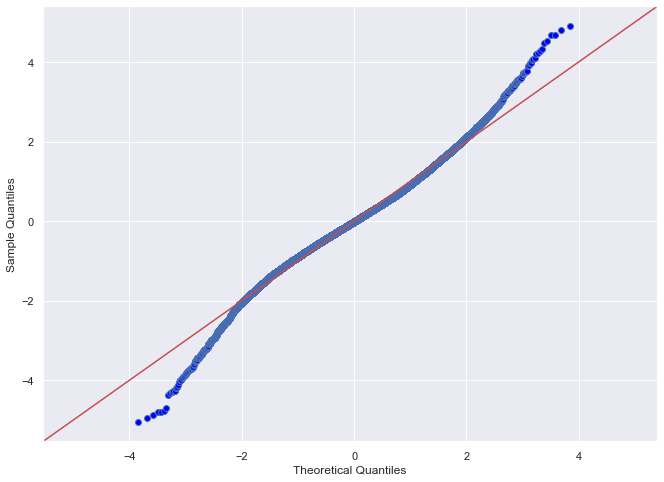

In [78]:
fig = sm.graphics.qqplot(model_2.resid, dist=stats.norm, line='45', fit=True)

* Residual plot remains unchanged

## 3.4 Model 3

At this point, I would like to see how removing a few features affects our model

In [79]:
X2 = df.drop(['sqft_lot', 'sqft_basement', 'bedrooms', 'bathrooms', 'floors',
              'cond_2', 'cond_3', 'price'], 1)

y2 =price_log

In [80]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size=0.2, random_state=11)

In [81]:
scaler2 = StandardScaler()
scalerp2 = StandardScaler()

X_train2[[ 'sqft_living', 'lat', 'long', 'zip_med_inc']] = scaler2.fit_transform(
                    X_train2[[ 'sqft_living', 'lat', 'long', 'zip_med_inc']])


X_test2[[ 'sqft_living', 'lat', 'long', 'zip_med_inc']] = scaler2.transform(
                    X_test2[[ 'sqft_living', 'lat', 'long', 'zip_med_inc']])

y_train2 = scalerp2.fit_transform(pd.DataFrame(y_train2))
y_test2 = scalerp2.transform(pd.DataFrame(y_test2))

<ipython-input-81-41518915a878>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_train2[[ 'sqft_living', 'lat', 'long', 'zip_med_inc']] = scaler2.fit_transform(
C:\Users\saifw\anaconda3\lib\site-packages\pandas\core\indexing.py:1736: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value[:, i].tolist())
<ipython-input-81-41518915a878>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

In [82]:
X_train2 = pd.DataFrame(X_train2, columns = X2.columns)


In [83]:
predictors = sm.add_constant(X_train2)
model_3 = sm.OLS(y_train2 , predictors).fit()
model_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.812
Model:                            OLS   Adj. R-squared:                  0.812
Method:                 Least Squares   F-statistic:                     6700.
Date:                Thu, 25 Mar 2021   Prob (F-statistic):               0.00
Time:                        13:52:16   Log-Likelihood:                -9990.4
No. Observations:               17106   AIC:                         2.000e+04
Df Residuals:                   17094   BIC:                         2.010e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const          -0.2169      0.006    -35.498      0.000      -0.229      -0.205
sqft_living     0.4642      0.004    105.702      0.000       0.456       0.473
waterfront      0.9901      0.050     19.863      0.000       0.892       1.088
view            0.3618      0.012     29.704      0.000       0.338       0.386
lat            -0.3137      0.005    -69.685      0.000      -0.322      -0.305
long           -0.1313      0.004    -34.559      0.000      -0.139      -0.124
zip_med_inc     0.3140      0.005     65.474      0.000       0.305       0.323
grade_2         0.2707      0.009     31.671      0.000       0.254       0.287
grade_3         0.7870      0.028     28.174      0.000       0.732       0.842
grade_4         1.8496      0.434      4.259      0.000       0.998       2.701
cond_4          0.0961      0.008     12.309      0.000       0.081       0.111
cond_5          0.2117      0.013     16.590      0.000       0.187       0.237
==============================================================================
Omnibus:                      550.301   Durbin-Watson:                   2.010
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1492.115
Skew:                           0.066   Prob(JB):                         0.00
Kurtosis:                       4.441   Cond. No.                         177.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

* I'm pretty happy with this model.
* It looks like the three features that stand out are Living Area, Latitude and Zipcode Median Income

# 4.  Linear Regression on Best Model

In this case, our best model appears to be Model 3

In [84]:
linreg2= LinearRegression()
linreg2.fit(X_train2, y_train)

# make predictions
y_hat2 = linreg2.predict(X_test2)
sss = y_hat2
y_hat2 = scalerp2.inverse_transform(y_hat2)

y_hat2 = np.exp(y_hat2)

In [85]:
# Use Linear Regression to make predictions for train and test data
y_hat_train = linreg2.predict(X_train2)
y_hat_test = linreg2.predict(X_test2)


# Undo Scaling
y_train2 = scalerp.inverse_transform(y_train2)
y_test2 = scalerp.inverse_transform(y_test2)
y_hat_train = scalerp.inverse_transform(y_hat_train)
y_hat_test = scalerp.inverse_transform(y_hat_test)


resids = y_hat_test - y_test2

# Undo log transformation
y_train2 = np.exp(y_train2)
y_test2 = np.exp(y_test2)
y_hat_train = np.exp(y_hat_train)
y_hat_test = np.exp(y_hat_test)



In [86]:
# Calculate Root Mean Square Error
train_rmse = np.sqrt(mean_squared_error(y_train2, y_hat_train))
test_rmse = np.sqrt(mean_squared_error(y_test2, y_hat_test))

# Calculate Mean Absolute Error
test_mae = mean_absolute_error(y_test2, y_hat_test)
train_mae = mean_absolute_error(y_train2, y_hat_train)

In [87]:
print(f'Train Root Mean Square Error: {train_rmse}')
print(f'Test Root Mean Square Error: {test_rmse}')


Train Root Mean Square Error: 132126.42151294308
Test Root Mean Square Error: 128669.4248050033


In [88]:
print(f'Train Mean Absolute Error: {train_mae}')
print(f'Test Mean Absolute Error: {test_mae}')


Train Mean Average Error: 85384.82997302554
Test Mean Average Error: 83593.52851716784


* Both RMSE and MAE are lower for the test data than the train data which indicates that we did not overfit

In [89]:


cvs_5  = np.mean(cross_val_score(linreg2, X2, y2, cv=5,  scoring='neg_mean_squared_error'))
cvs_10 = np.mean(cross_val_score(linreg2, X2, y2, cv=10, scoring='neg_mean_squared_error'))
cvs_20 = np.mean(cross_val_score(linreg2, X2, y2, cv=20, scoring='neg_mean_squared_error'))


mae = np.mean(cross_val_score(linreg2, X2, y2, cv=5,  scoring='neg_mean_absolute_error'))

In [90]:
print(f'Cross Value Score 5 Folds: {np.sqrt(-cvs_5)}')
print(f'Cross Value Score 10 Folds: {np.sqrt(-cvs_10)}')
print(f'Cross Value Score 20 Folds: {np.sqrt(-cvs_20)}')
print(f'Mean Absolute Error: {-mae}')

Cross Value Score 5 Folds: 0.21604764754762146
Cross Value Score 10 Folds: 0.21600987420313705
Cross Value Score 20 Folds: 0.2158707897721276
Mean Average Error: 0.16381927921545245


<AxesSubplot:ylabel='Count'>

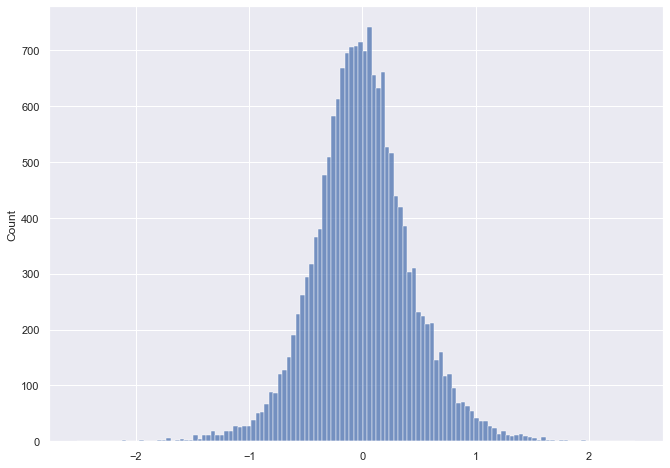

In [91]:
sns.histplot(model_3.resid)

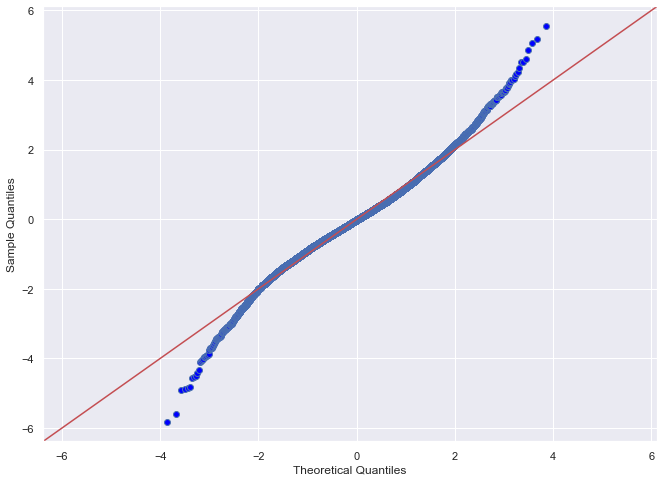

In [92]:
fig = sm.graphics.qqplot(model_3.resid, dist=stats.norm, line='45', fit=True)


<AxesSubplot:>

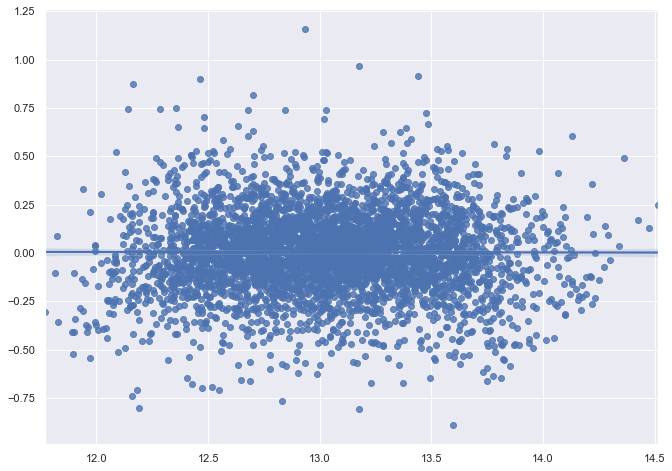

In [93]:
sns.regplot(x=np.log(y_hat_test), y=resids)

<AxesSubplot:>

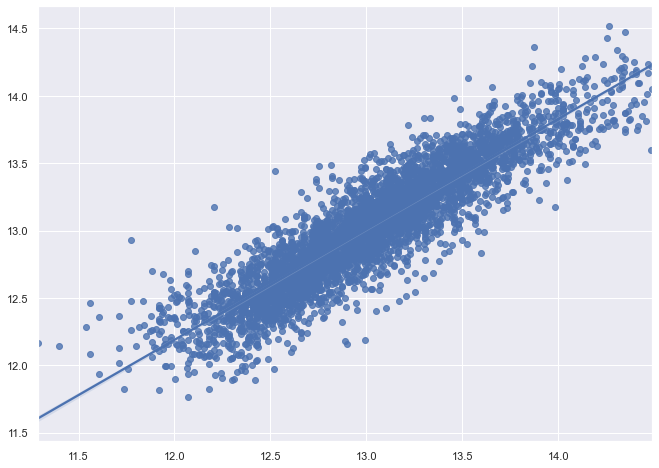

In [94]:
sns.regplot(x=np.log(y_test2), y=np.log(y_hat_test))

* Our residuals appear to be normal, but there is an issue with heavy tails.

# 5. Conclusions

Based on our model, the factors most affecting the price of a house are:
* Living area(sqft_living)
* Location(lat, zip_med_inc)
* If it's a waterfront property(waterfront)
* Quality of the house(grade)

## 5.1 Explanations of Parameters and Statistics

* We have a model that has an Coefficient of Determination(R-squared) value of 0.812 which indicates that our model can explain 81.2% of all vatiation in the data around the mean.  This is a bit higher than I had expected at the start of the project, but performing feature engineering on the latitude and zipcode columns appears to have helped.

* With a Mean Squared Error of around $85,000, that means our predicted price is, on average, 85,000 off from our mean of approximately 518,500. While that number doesn't look too bad our Root Mean Squared Error is around 130,000 which means that our model is being heavily penalized for predictions that are very far off the actual price.

* An explanation for that discrepancy might be the distribution of our residuals.  While the distribution is has a normal shape, the tails are heavy which indicates that we have some predictions that are inaccurate by large margins.  This requires further analysis as the residual plot could be improved by adding more features, using a different method than OLS to judge our model, or do more feature engineering. 

## 5.2 Next Steps

* The data we were provided is at least 6 years old which makes it pretty outdated.  Acquiring a more recent dataset would help make the findings more relevant to the present.

* We should be able to get a lot more out of the location data.  I would like to make a gradient of the price with the latitude/longitude as the x/y axis.  We can use this gradient to give weighted values to specific coordinates.

* The most obvious next step is to try out new modeling techniques.  While linear regression is a good start, there are many other techniques that I believe could help make better predictions.  Of particular insterest to me in this context are Polynomial Regression and Weighted Least Squares.

# 6. Visuals for presentation

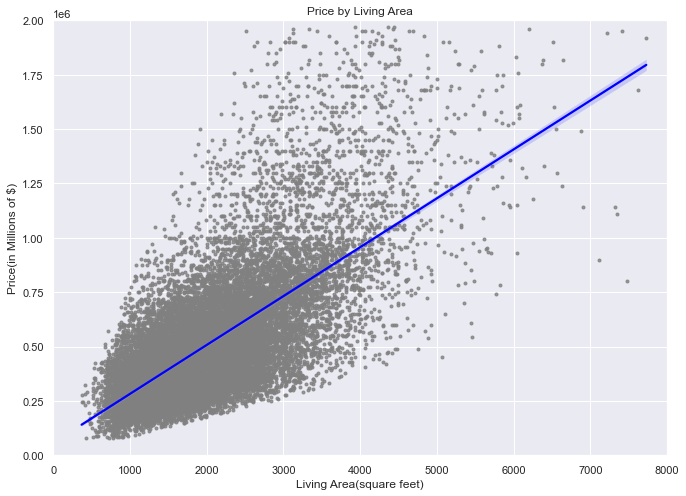

In [96]:

fig = plt.figure(figsize=(11,8))
ax = sns.regplot(data=df99, x='sqft_living', y='price', marker='.',
     scatter_kws={"color": "grey"}, line_kws={"color": "blue"})

ax.set(  xlabel='Living Area(square feet)',
         ylabel='Price(in Millions of $)', 
         title='Price by Living Area',
 )


plt.xlim([0,8000])
plt.ylim([0, 2000000])
plt.show()

[[Text(0, 0, '3-7'),
  Text(1, 0, '8-10'),
  Text(2, 0, '11-12'),
  Text(3, 0, '13')],
 Text(0.5, 0, 'Grade'),
 Text(0, 0.5, 'Price (in Millions of $)'),
 Text(0.5, 1.0, 'Price by Grade')]

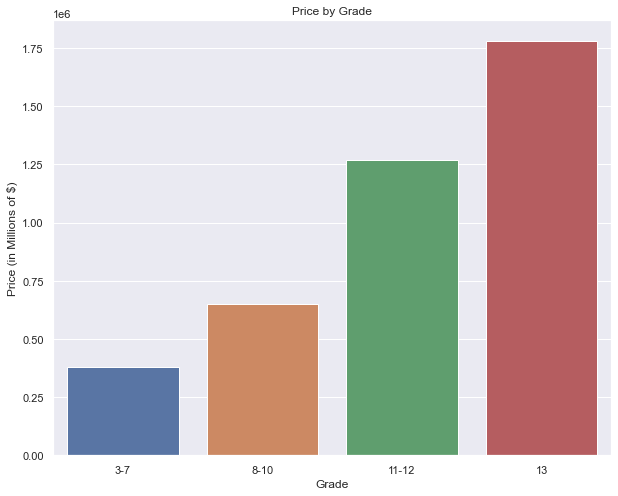

In [97]:
fig = plt.figure(figsize=(10,8))
ax = sns.barplot(data=df_clean, x='grade', y='price', ci=None)
ax.set( xticklabels=(['3-7', '8-10', '11-12', '13']),
        xlabel='Grade',
        ylabel='Price (in Millions of $)', 
        title='Price by Grade'  )

[[Text(0, 0, 'No'), Text(1, 0, 'Yes')],
 Text(0.5, 0, 'Waterfront'),
 Text(0, 0.5, 'Price (in Millions of $)'),
 Text(0.5, 1.0, 'Price for Waterfront View')]

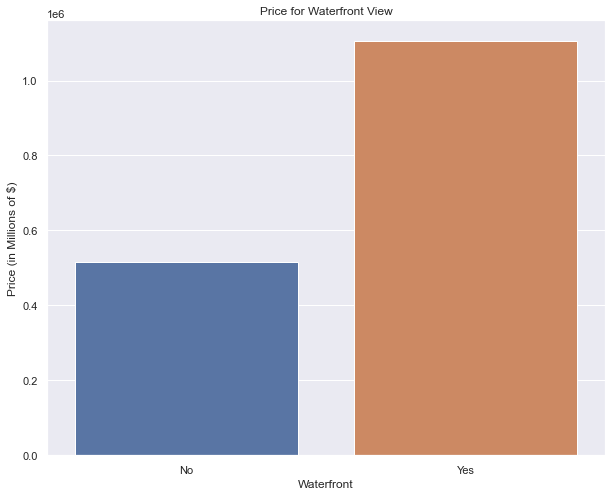

In [98]:
fig = plt.figure(figsize=(10,8))
ax = sns.barplot(data=df_clean, x='waterfront', y='price', ci=None,)
ax.set( xticklabels=(['No', 'Yes']),
        xlabel='Waterfront',
        ylabel='Price (in Millions of $)', 
        title='Price for Waterfront View')


There is an additional visualization about locations that is made under Locations, locations, locations.

NOnt technical

:Combine data and modeling slides.  Take out technical modeling names.
Slide talking about model performance.

Notebook

Calculate RMSE and MAE for each model

Model comparison(table)

Expand on engineered feature(location)

Dollars


